<font size=5> Tabular Series Mar </font>

The competition aims to build a machine learning Regresion model to predict target. The model evalvation metric is rmse.

# Import library

In [12]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import re
import scipy.stats as stats

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import KFold, train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
import lightgbm as lgb
import catboost as cgb

plt.style.use('seaborn-whitegrid')
pd.set_option.max_columns=100
seed = 42

## Import dataset

In [13]:
train = pd.read_csv('input/train.csv')
test = pd.read_csv('input/test.csv')

strf = f"""
train shape {train.shape}
test  shape {test.shape}
"""
print(strf)


train shape (300000, 32)
test  shape (200000, 31)



## Glimse Data

In [5]:
train.head()

,id,cat0,cat1,cat2,cat3,cat4,cat5,cat6,cat7,cat8,...,cont2,cont3,cont4,cont5,cont6,cont7,cont8,cont9,cont10,target
0,0,A,I,A,B,B,BI,A,S,Q,...,0.759439,0.795549,0.681917,0.621672,0.592184,0.791921,0.815254,0.965006,0.665915,0
1,1,A,I,A,A,E,BI,K,W,AD,...,0.386385,0.541366,0.388982,0.357778,0.600044,0.408701,0.399353,0.927406,0.493729,0
2,2,A,K,A,A,E,BI,A,E,BM,...,0.343255,0.616352,0.793687,0.552877,0.352113,0.388835,0.412303,0.292696,0.549452,0
3,3,A,K,A,C,E,BI,A,Y,AD,...,0.831147,0.807807,0.800032,0.619147,0.221789,0.897617,0.633669,0.760318,0.934242,0
4,4,A,I,G,B,E,BI,C,G,Q,...,0.338818,0.277308,0.610578,0.128291,0.578764,0.279167,0.351103,0.357084,0.328960,1


In [6]:
test.head()

,id,cat0,cat1,cat2,cat3,cat4,cat5,cat6,cat7,cat8,...,cont1,cont2,cont3,cont4,cont5,cont6,cont7,cont8,cont9,cont10
0,5,A,F,A,A,F,BI,A,AH,AX,...,0.735690,0.578366,0.723154,0.228037,0.356227,0.551249,0.655693,0.598331,0.359987,0.947489
1,6,A,H,C,A,E,AB,I,F,N,...,0.313703,0.928885,0.516602,0.600169,0.795224,0.248987,0.654614,0.347944,0.565520,0.388580
2,8,A,N,C,A,F,AB,A,AH,BC,...,0.448201,0.424876,0.344729,0.242073,0.270632,0.746740,0.335590,0.341238,0.252289,0.411592
3,9,B,L,C,A,F,BI,A,E,AX,...,0.666092,0.598943,0.561971,0.806347,0.735983,0.538724,0.381566,0.481660,0.348514,0.325723
4,11,A,F,A,B,F,BI,A,AH,I,...,0.772229,0.479572,0.767745,0.252454,0.354810,0.178920,0.763479,0.562491,0.466261,0.585781


In [8]:
train.columns

Index(['id', 'cat0', 'cat1', 'cat2', 'cat3', 'cat4', 'cat5', 'cat6', 'cat7',
       'cat8', 'cat9', 'cat10', 'cat11', 'cat12', 'cat13', 'cat14', 'cat15',
       'cat16', 'cat17', 'cat18', 'cont0', 'cont1', 'cont2', 'cont3', 'cont4',
       'cont5', 'cont6', 'cont7', 'cont8', 'cont9', 'cont10', 'target'],
      dtype='object')

In [14]:
d = {'train_unique':train.nunique(),'test_unique':test.nunique(),'train_na':train.isnull().mean(),
    'test_na':test.isnull().mean()}
pd.DataFrame(d)

,train_unique,test_unique,train_na,test_na
cat0,2,2.0,0.0,0.0
cat1,15,15.0,0.0,0.0
cat10,299,295.0,0.0,0.0
cat11,2,2.0,0.0,0.0
cat12,2,2.0,0.0,0.0
cat13,2,2.0,0.0,0.0
cat14,2,2.0,0.0,0.0
cat15,4,4.0,0.0,0.0
cat16,4,4.0,0.0,0.0
cat17,4,4.0,0.0,0.0


/home/sudhir/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='target', ylabel='count'>

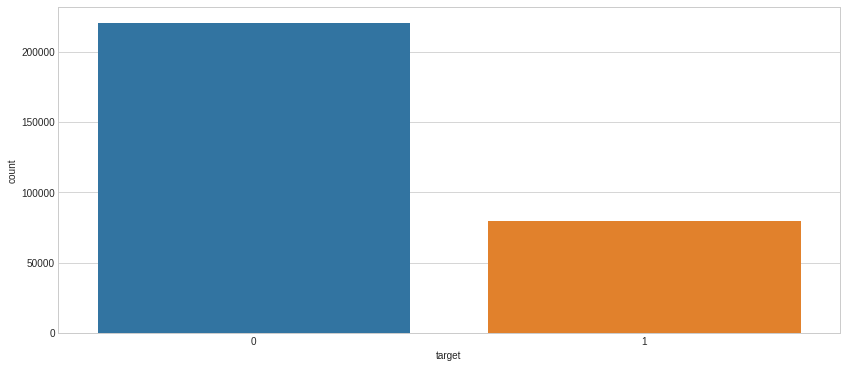

In [26]:
f,ax = plt.subplots(1,1,figsize=(14,6),)

sns.countplot(train['target'])
# ax[0].bar(train['target'],train['target'])


In [5]:
cat_cols = train.columns[train.columns.str.startswith('cat')].values
cat_cols

array(['cat0', 'cat1', 'cat2', 'cat3', 'cat4', 'cat5', 'cat6', 'cat7',
       'cat8', 'cat9'], dtype=object)

In [6]:
cols = train.columns[train.columns.str.startswith('cont')].values
cols

array(['cont0', 'cont1', 'cont2', 'cont3', 'cont4', 'cont5', 'cont6',
       'cont7', 'cont8', 'cont9', 'cont10', 'cont11', 'cont12', 'cont13'],
      dtype=object)

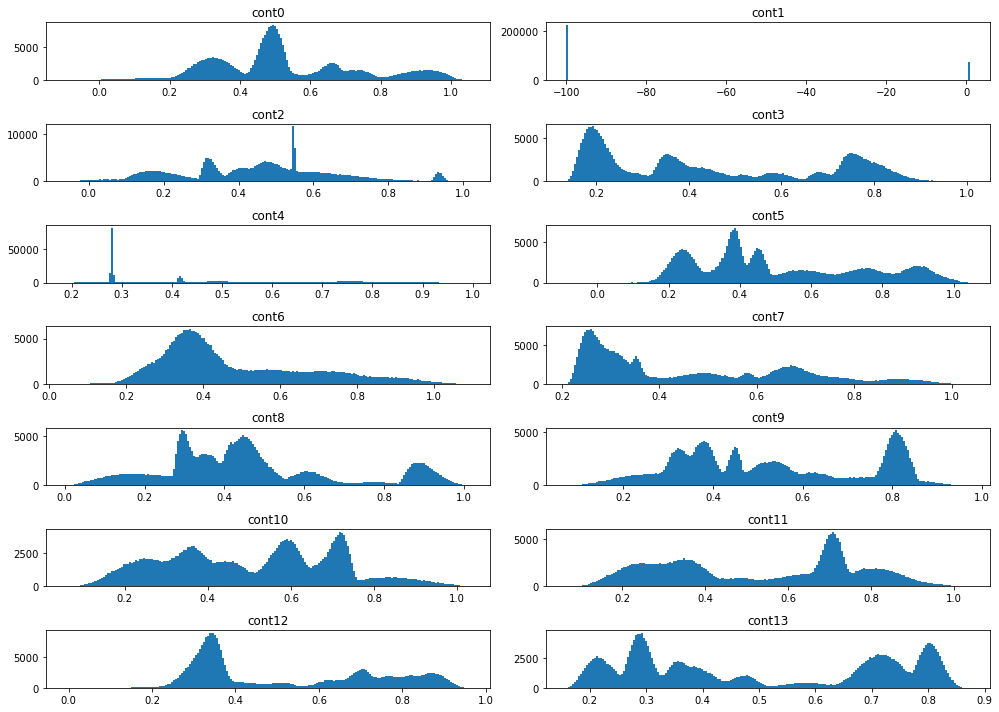

In [73]:
f,ax = plt.subplots(nrows=7,ncols=2,figsize=(14,10))
for i,col in enumerate(cols):
    ax[int(i/2),i%2].set_title(col)
    ax[int(i/2),i%2].hist(df[col],bins=200);

plt.tight_layout()

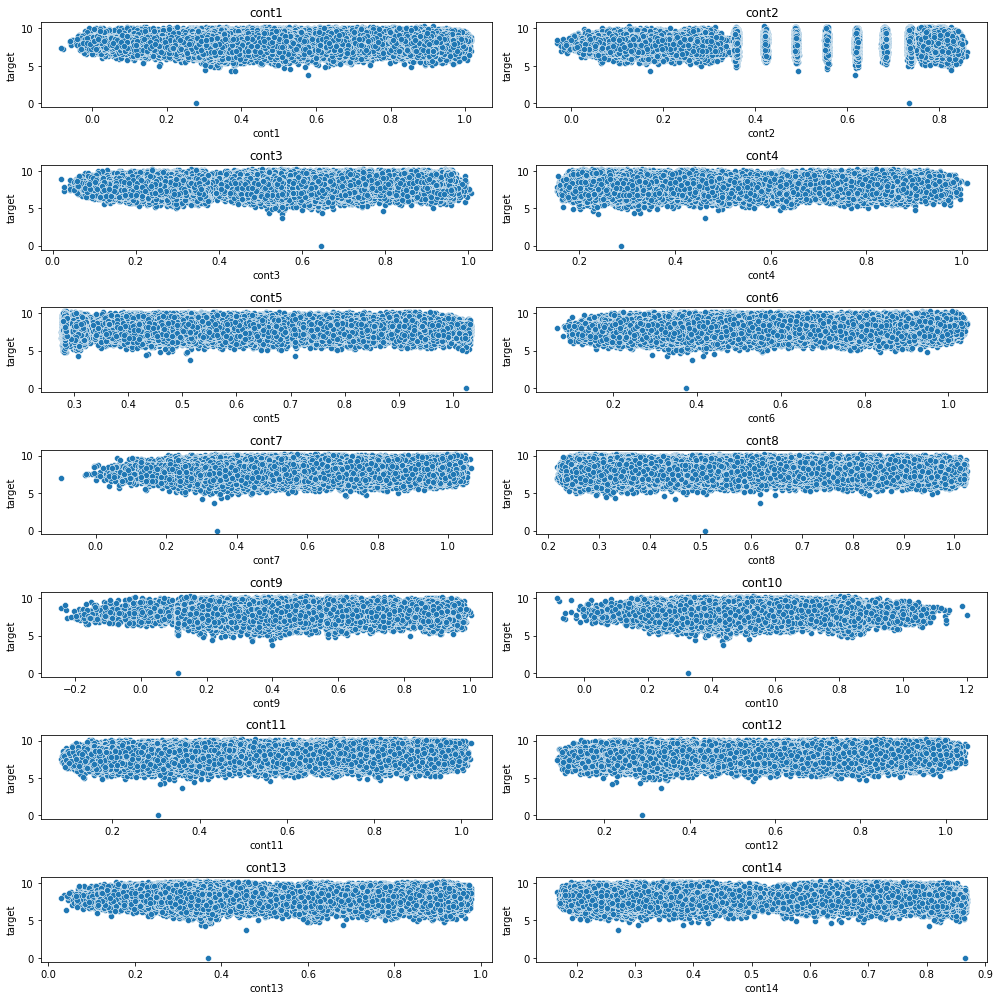

In [50]:

f,ax = plt.subplots(nrows=7,ncols=2,figsize=(14,14))
for i,col in enumerate(cols):
    a = ax[int(i/2),i%2]
    a.set_title(col)
    sns.scatterplot(x=df[col],y=df['target'],sizes=df['target'],ax=a)

plt.tight_layout()

In [52]:
from sklearn.preprocessing import QuantileTransformer
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics

In [7]:
X_all = pd.concat([train.drop(['id','target'],axis=1),test.drop(['id'],axis=1)])
y = train['target']

# Label Encoding

In [12]:
for col in cat_cols:
    print(f"{col}, nunique{X_all[col].nunique()}")
    le = LabelEncoder().fit(X_all[col])
    X_all[col] = le.transform(X_all[col])

cat0, nunique2
cat1, nunique2
cat2, nunique2
cat3, nunique4
cat4, nunique4
cat5, nunique4
cat6, nunique8
cat7, nunique8
cat8, nunique7
cat9, nunique15


In [16]:
X = X_all[:len(y)]
X_test = X_all[len(y):]

X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=seed)

# Model

In [32]:
rf = RandomForestRegressor( n_estimators=100,
    criterion='mse',
    max_depth=6,
    min_samples_split=30,
    min_samples_leaf=30,
    min_weight_fraction_leaf=0.0,
    max_features='auto',
    min_impurity_split=None,
    n_jobs =-1             
    )

In [36]:
rf.fit(X_train,y_train)

RandomForestRegressor(max_depth=6, min_samples_leaf=30, min_samples_split=30,
                      n_jobs=-1)

In [37]:
pred = rf.predict(X_valid)
metrics.mean_squared_error(y_valid,pred)**0.5

0.8662625460244382

In [29]:
# submission
print('shape',X_test.shape)
sub = test[['id']]
pred = rf.predict(X_test)
sub['target'] = pred

shape (200000, 24)


<ipython-input-29-d8478c62b414>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub['target'] = pred


In [30]:
# sub.to_csv('sub.csv',index=False)

In [61]:
param = {'cat_features' : list(cat_cols),
    'metric': 'rmse',
    'seed': seed,
    "learning_rate":0.01,
    'n_estimators': 10000
    }
model = lgb.LGBMRegressor(**param)

In [62]:
model.fit(X_train,y_train,eval_set=[(X_valid,y_valid)],
          early_stopping_rounds=300,verbose=100)

Training until validation scores don't improve for 300 rounds
[100]	valid_0's rmse: 0.868482
[200]	valid_0's rmse: 0.860518
[300]	valid_0's rmse: 0.855926
[400]	valid_0's rmse: 0.852996
[500]	valid_0's rmse: 0.85098
[600]	valid_0's rmse: 0.849532
[700]	valid_0's rmse: 0.848423
[800]	valid_0's rmse: 0.847464
[900]	valid_0's rmse: 0.846767
[1000]	valid_0's rmse: 0.846192
[1100]	valid_0's rmse: 0.845785
[1200]	valid_0's rmse: 0.845507
[1300]	valid_0's rmse: 0.845314
[1400]	valid_0's rmse: 0.845127
[1500]	valid_0's rmse: 0.845012
[1600]	valid_0's rmse: 0.844901
[1700]	valid_0's rmse: 0.844801
[1800]	valid_0's rmse: 0.84471
[1900]	valid_0's rmse: 0.84462
[2000]	valid_0's rmse: 0.844576
[2100]	valid_0's rmse: 0.844518
[2200]	valid_0's rmse: 0.844488
[2300]	valid_0's rmse: 0.844437
[2400]	valid_0's rmse: 0.844407
[2500]	valid_0's rmse: 0.844367
[2600]	valid_0's rmse: 0.844349
[2700]	valid_0's rmse: 0.844316
[2800]	valid_0's rmse: 0.844297
[2900]	valid_0's rmse: 0.844264
[3000]	valid_0's rmse:

LGBMRegressor(cat_features=['cat0', 'cat1', 'cat2', 'cat3', 'cat4', 'cat5',
                            'cat6', 'cat7', 'cat8', 'cat9'],
              learning_rate=0.01, metric='rmse', n_estimators=10000, seed=42)

In [64]:
pred = model.predict(X_valid)
metrics.mean_squared_error(y_valid,pred)**0.5

0.8441811417120353

In [65]:
# submission
print('shape',X_test.shape)
sub = test[['id']]
pred = model.predict(X_test)
sub['target'] = pred

shape (200000, 24)


<ipython-input-65-33a277fbe5c3>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub['target'] = pred


In [66]:
sub.to_csv('input/submission.csv',index=False)

In [71]:
param = {'cat_features' : list(cat_cols),
    'eval_metric': 'RMSE',
    'random_seed': seed,
    'n_estimators': 10000
    }
model = cgb.CatBoostRegressor(**param)

In [72]:
model.fit(X_train,y_train,eval_set=[(X_valid,y_valid)],
          early_stopping_rounds=300,verbose=100)

Learning rate set to 0.030928
0:	learn: 0.8859690	test: 0.8875019	best: 0.8875019 (0)	total: 459ms	remaining: 1h 16m 26s
100:	learn: 0.8584137	test: 0.8590471	best: 0.8590471 (100)	total: 26.3s	remaining: 43m
200:	learn: 0.8526709	test: 0.8534611	best: 0.8534611 (200)	total: 56.5s	remaining: 45m 52s
300:	learn: 0.8495876	test: 0.8508021	best: 0.8508021 (300)	total: 1m 31s	remaining: 49m 2s
400:	learn: 0.8472661	test: 0.8490409	best: 0.8490409 (400)	total: 2m 6s	remaining: 50m 24s
500:	learn: 0.8450362	test: 0.8474030	best: 0.8474030 (500)	total: 2m 50s	remaining: 53m 54s
600:	learn: 0.8432585	test: 0.8463142	best: 0.8463142 (600)	total: 3m 27s	remaining: 54m 12s
700:	learn: 0.8418325	test: 0.8455482	best: 0.8455482 (700)	total: 4m 3s	remaining: 53m 54s
800:	learn: 0.8406428	test: 0.8450580	best: 0.8450580 (800)	total: 4m 38s	remaining: 53m 16s
900:	learn: 0.8395155	test: 0.8446646	best: 0.8446622 (899)	total: 5m 14s	remaining: 52m 56s
1000:	learn: 0.8384601	test: 0.8443268	best: 0.8443

In [73]:
# submission
print('shape',X_test.shape)
sub = test[['id']]
pred = model.predict(X_test)
sub['target'] = pred

shape (200000, 24)


<ipython-input-73-33a277fbe5c3>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub['target'] = pred


In [74]:
sub.to_csv('input/submission.csv',index=False)

In [34]:
from scipy import stats

In [36]:
stats.norm.ppf(0.5,loc=9)

9.0

In [36]:
from sklearn.mixture import GaussianMixture

In [37]:
y = df['target'].values.reshape(-1, 1)
gmm = GaussianMixture(n_components=2, random_state=42)
gmm.fit(y)
y_pred = gmm.predict(y)

In [38]:
proba = gmm.predict_proba(y)

In [22]:
np.concatenate([proba,proba],axis=1)[:,:-1]

array([[1.09132814e-01, 8.90867186e-01, 1.09132814e-01],
       [9.13095226e-01, 8.69047740e-02, 9.13095226e-01],
       [1.71133150e-04, 9.99828867e-01, 1.71133150e-04],
       ...,
       [6.35215447e-01, 3.64784553e-01, 6.35215447e-01],
       [9.54744532e-01, 4.52554679e-02, 9.54744532e-01],
       [8.02778072e-04, 9.99197222e-01, 8.02778072e-04]])

(array([92002., 25524., 15079., 11002.,  9241.,  9141., 10141., 13114.,
        20001., 94755.]),
 array([4.26357130e-04, 1.00383721e-01, 2.00341086e-01, 3.00298450e-01,
        4.00255814e-01, 5.00213179e-01, 6.00170543e-01, 7.00127907e-01,
        8.00085271e-01, 9.00042636e-01, 1.00000000e+00]),
 <BarContainer object of 10 artists>)

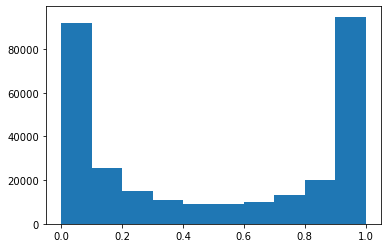

In [42]:
plt.hist(proba[:,1])

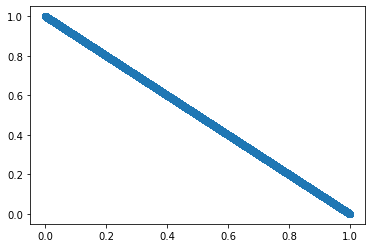

In [40]:
plt.scatter(proba[:,0],proba[:,1])

In [24]:
gmm.means_

array([[8.12894702],
       [6.77607298]])

# Feature

In [3]:
d = pd.read_csv('input/train_folds.csv')

In [5]:
d_all = d.drop(['id','kfold','target'],axis=1)
corr_matrix = d_all.corr()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
upper   

to_drop = [column for column in upper.columns if any(upper[column] > 0.93)]
print(to_drop)

['cat2_cat13', 'cat2_cat14', 'cat4_cat14', 'cat9_cat14', 'cat13_cat16', 'cont0_cont2', 'cont0_cont10', 'cont1_cont10', 'cont2_cont3', 'cont2_cont4', 'cont2_cont5', 'cont2_cont6', 'cont2_cont7', 'cont2_cont8', 'cont2_cont9', 'cont2_cont10', 'cont3_cont7', 'cont3_cont10', 'cont7_cont10', 'cont9_cont10']


In [24]:
cols= d_all.columns[d_all.columns.str.startswith('cat10')]
corr_matrix = d_all[cols].corr()

In [25]:
corr_matrix

,cat10,cat10_cat11,cat10_cat12,cat10_cat13,cat10_cat14,cat10_cat15,cat10_cat16,cat10_cat17,cat10_cat18
cat10,1.000000,-0.349275,-0.349275,-0.349275,-0.349275,-0.349275,-0.349275,-0.349275,-0.349275
cat10_cat11,-0.349275,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
cat10_cat12,-0.349275,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
cat10_cat13,-0.349275,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
cat10_cat14,-0.349275,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
cat10_cat15,-0.349275,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
cat10_cat16,-0.349275,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
cat10_cat17,-0.349275,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
cat10_cat18,-0.349275,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [23]:
d.drop(to_drop,axis=1).columns

Index(['cat0', 'cat1', 'cat2', 'cat3', 'cat4', 'cat5', 'cat6', 'cat7', 'cat8',
       'cat9', 'cat10', 'cat11', 'cat12', 'cat13', 'cat14', 'cat15', 'cat16',
       'cat17', 'cat18', 'cont1_gmm', 'cont2_gmm', 'cont3_gmm', 'cont4_gmm',
       'cont5_gmm', 'cont6_gmm', 'cont7_gmm', 'cont8_gmm', 'cont9_gmm',
       'cont10_gmm', 'cat0_cat1', 'cat1_cat2', 'cat2_cat3', 'cat3_cat4',
       'cat4_cat5', 'cat5_cat6', 'cat6_cat7', 'cat7_cat8', 'cat8_cat9',
       'cat9_cat10', 'cat10_cat11', 'cat11_cat12', 'cat12_cat13',
       'cat13_cat14', 'cat14_cat15', 'cat15_cat16', 'cont0_cont1',
       'cont1_cont2', 'cont2_cont3', 'cont3_cont4', 'cont4_cont5',
       'cont5_cont6', 'cont6_cont7', 'cont7_cont8', 'cont8_cont9',
       'cont9_cont10', 'cont0', 'cont4', 'cont7', 'cont8', 'cont9', 'cont10',
       'target', 'id', 'kfold'],
      dtype='object')

In [9]:
to_drop

['cat2_cat13',
 'cat2_cat14',
 'cat4_cat14',
 'cat9_cat14',
 'cat13_cat16',
 'cont0_cont2',
 'cont0_cont10',
 'cont1_cont10',
 'cont2_cont3',
 'cont2_cont4',
 'cont2_cont5',
 'cont2_cont6',
 'cont2_cont7',
 'cont2_cont8',
 'cont2_cont9',
 'cont2_cont10',
 'cont3_cont7',
 'cont3_cont10',
 'cont7_cont10',
 'cont9_cont10']

In [21]:
d.columns.values

array(['cat0', 'cat1', 'cat2', 'cat3', 'cat4', 'cat5', 'cat6', 'cat7',
       'cat8', 'cat9', 'cat10', 'cat11', 'cat12', 'cat13', 'cat14',
       'cat15', 'cat16', 'cat17', 'cat18', 'cont1_gmm', 'cont2_gmm',
       'cont3_gmm', 'cont4_gmm', 'cont5_gmm', 'cont6_gmm', 'cont7_gmm',
       'cont8_gmm', 'cont9_gmm', 'cont10_gmm', 'cat0_cat1', 'cat0_cat2',
       'cat0_cat3', 'cat0_cat4', 'cat0_cat5', 'cat0_cat6', 'cat0_cat7',
       'cat0_cat8', 'cat0_cat9', 'cat0_cat10', 'cat0_cat11', 'cat0_cat12',
       'cat0_cat13', 'cat0_cat14', 'cat0_cat15', 'cat0_cat16',
       'cat0_cat17', 'cat0_cat18', 'cat1_cat2', 'cat1_cat3', 'cat1_cat4',
       'cat1_cat5', 'cat1_cat6', 'cat1_cat7', 'cat1_cat8', 'cat1_cat9',
       'cat1_cat10', 'cat1_cat11', 'cat1_cat12', 'cat1_cat13',
       'cat1_cat14', 'cat1_cat15', 'cat1_cat16', 'cat1_cat17',
       'cat1_cat18', 'cat2_cat3', 'cat2_cat4', 'cat2_cat5', 'cat2_cat6',
       'cat2_cat7', 'cat2_cat8', 'cat2_cat9', 'cat2_cat10', 'cat2_cat11',
       'cat2_cat12

In [7]:
cols = ['cont1_gmm_2', 'cont1_gmm_3', 'cont2_gmm_1', 'cont2_gmm_2',
       'cont2_gmm_3', 'cont2_gmm_4', 'cont2_gmm_5', 'cont2_gmm_6',
       'cont2_gmm_7', 'cont2_gmm_8', 'cont2_gmm_9', 'cont3_gmm_1',
       'cont3_gmm_2', 'cont3_gmm_3', 'cont3_gmm_4', 'cont3_gmm_5',
       'cont4_gmm_1', 'cont4_gmm_2', 'cont4_gmm_3', 'cont5_gmm_1',
       'cont5_gmm_2', 'cont6_gmm_1', 'cont7_gmm_1', 'cont7_gmm_2',
       'cont8_gmm_1', 'cont8_gmm_2', 'cont8_gmm_3', 'cont9_gmm_1',
       'cont9_gmm_2', 'cont9_gmm_3', 'cont10_gmm_1', 'cont10_gmm_2',
       'cont10_gmm_3', 'cont10_gmm_4', 'cont10_gmm_5', 'cont10_gmm_6',
       'cont10_gmm_7', 'cont11_gmm_1', 'cont11_gmm_2', 'cont11_gmm_3',
       'cont11_gmm_4', 'cont12_gmm_1', 'cont12_gmm_2', 'cont12_gmm_3',
       'cont13_gmm_1', 'cont13_gmm_2', 'cont13_gmm_3', 'cont13_gmm_4',
       'cont13_gmm_5']
for c in cols:
    d[c].hist()

KeyError: 'cont1_gmm_2'

In [67]:
d.isnull().mean()

cat0_B    0.0
cat1_B    0.0
cat2_B    0.0
cat3_B    0.0
cat3_C    0.0
         ... 
cont12    1.0
cont13    1.0
target    0.0
id        0.0
kfold     0.0
Length: 63, dtype: float64

In [51]:
col = 'cont1'
df[col].quantile(0.75)

0.6881497714913689

In [14]:
sub1 = pd.read_csv('model_preds/submission.csv')
sub2 = pd.read_csv('model_preds/submission_best.csv')

In [24]:
sub = sub1[['target']]
sub['target1'] = sub2['target']

In [27]:
sub.corr()

,target,target1
target,1.000000,0.995299
target1,0.995299,1.000000


In [6]:
len(to_drop)

20

In [30]:
sub3 = sub1.copy()

In [31]:
sub3['target'] = (sub1['target']**1.5 + sub1['target']**1.5)/2

In [19]:
sub3['target'] = (1.7*sub1['target'] + 0.3*sub2['target'])/2

In [32]:
sub3.to_csv('model_preds/submission_combine.csv',index=False)

<AxesSubplot:ylabel='Frequency'>

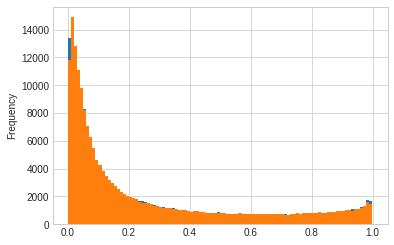

In [16]:
sub1['target'].plot(kind='hist',bins=100)
sub2['target'].plot(kind='hist',bins=100)

In [64]:
df[col] = np.where(df['cont1']>0.6881497714913689,df['cont1'],-100)

In [45]:
d.isnull().sum().sort_values()

cat0_B         0
cat8_B         0
cat8_C         0
cat8_D         0
cat8_E         0
           ...  
cont2     300000
cont1     300000
cont0     300000
cont8     300000
cont3     300000
Length: 63, dtype: int64